In [ ]:
!pip install fastai --upgrade

Requirement already up-to-date: fastai in /usr/local/lib/python3.7/dist-packages (2.3.0)


In [ ]:
import os
import glob
import time
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm.notebook import tqdm
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.models.resnet import resnet18
from torch.utils.data import Dataset, DataLoader

from fastai.vision.learner import create_body
from fastai.vision.models.unet import DynamicUnet
from fastai.data.external import untar_data, URLs

In [ ]:
SIZE = 256

In [ ]:
class TrainingDataset(Dataset):
  def __init__(self, paths):
    self.transforms = transforms.Compose([
            transforms.Resize((SIZE, SIZE)),
            transforms.RandomHorizontalFlip(),
        ])
    self.paths = paths

  def __getitem__(self, idx):
    img = Image.open(self.paths[idx]).convert("RGB")
    img = self.transforms(img)
    img = np.array(img)

    lab_img = rgb2lab(img).astype("float32")
    lab_img = transforms.ToTensor()(lab_img)

    L = lab_img[[0], ...] / 50. - 1.
    ab = lab_img[[1, 2], ...] / 110.

    return {"L": L, "ab": ab}

  def __len__(self):
    return len(self.paths)

In [ ]:
class ValidationDataset(Dataset):
  def __init__(self, paths):
    self.transforms = transforms.Compose([
            transforms.Resize((SIZE, SIZE)),
        ])
    self.paths = paths

  def __getitem__(self, idx):
    img = Image.open(self.paths[idx]).convert("RGB")
    img = self.transforms(img)
    img = np.array(img)

    lab_img = rgb2lab(img).astype("float32")
    lab_img = transforms.ToTensor()(lab_img)

    L = lab_img[[0], ...] / 50. - 1.
    ab = lab_img[[1, 2], ...] / 110.

    return {"L": L, "ab": ab}

  def __len__(self):
    return len(self.paths)

In [ ]:
class CNNBlock(nn.Module):
  def __init__(self, in_channels, out_channels, stride):
    super().__init__()

    self.conv = nn.Sequential(
      nn.Conv2d(
          in_channels, out_channels, 4, stride, 1, bias=False, padding_mode="reflect"
      ),
      nn.BatchNorm2d(out_channels),
      nn.LeakyReLU(0.2),
    )

  def forward(self, x):
    return self.conv(x)

In [ ]:
class PatchDiscriminator(nn.Module):
  def __init__(self, x_channels, y_channels, features=[64, 128, 256, 512]):
    super().__init__()

    self.initial = nn.Sequential(
      nn.Conv2d(x_channels + y_channels, features[0], 4, 2, 1, padding_mode="reflect"),
      nn.LeakyReLU(0.2),
    )

    layers = []
    for i in range(1, len(features)):
      layers.append(
        CNNBlock(features[i-1], features[i], 1 if features[i] == features[-1] else 2),
      )

    layers.append(
      nn.Conv2d(features[-1], 1, 4, 1, 1, padding_mode="reflect"),
    )

    self.model = nn.Sequential(*layers)

  def forward(self, xy):
    xy = self.initial(xy)

    return self.model(xy)

In [ ]:
class GANLoss(nn.Module):
  def __init__(self, real_label=1., fake_label=0.):
    super().__init__()

    self.register_buffer("real_label", torch.tensor(real_label))
    self.register_buffer("fake_label", torch.tensor(fake_label))

    self.loss = nn.BCEWithLogitsLoss()

  def get_labels(self, preds, target_is_real):
    if target_is_real:
      return self.real_label.expand_as(preds)

    return self.fake_label.expand_as(preds)

  def __call__(self, preds, target_is_real):
    labels = self.get_labels(preds, target_is_real)

    return self.loss(preds, labels)

In [ ]:
class MainModel(nn.Module):
  def __init__(self, device, D, G, lr_G=2e-4, lr_D=2e-4, beta1=.5, beta2=.999, lambda_L1=100.):
    super().__init__()

    self.device = device

    self.D = D
    self.G = G

    self.GANcriterion = GANLoss().to(self.device)
    self.L1criterion = nn.L1Loss()

    self.opt_G = optim.Adam(self.G.parameters(), lr=lr_G, betas=(beta1, beta2))
    self.opt_D = optim.Adam(self.D.parameters(), lr=lr_D, betas=(beta1, beta2))

    self.lambda_L1 = lambda_L1

  def set_requires_grad(self, model, requires_grad):
    for parameter in model.parameters():
      parameter.requires_grad = requires_grad

  def setup_input(self, data):
    self.L = data["L"].to(self.device)
    self.ab = data["ab"].to(self.device)

  def forward(self):
    self.fake_color = self.G(self.L).to(device)

  def backward_D(self):
    fake_image = torch.cat([self.L, self.fake_color], dim=1)
    fake_preds = self.D(fake_image.detach())

    self.loss_D_fake = self.GANcriterion(fake_preds, False)

    real_image = torch.cat([self.L, self.ab], dim=1)
    real_preds = self.D(real_image)

    self.loss_D_real = self.GANcriterion(real_preds, True)

    self.loss_D = (self.loss_D_fake + self.loss_D_real) * .5

    self.loss_D.backward()

  def backward_G(self):
    fake_image = torch.cat([self.L, self.fake_color], dim=1)
    fake_preds = self.D(fake_image)

    self.loss_G_GAN = self.GANcriterion(fake_preds, True)
    self.loss_G_L1 = self.lambda_L1 * self.L1criterion(self.fake_color, self.ab)

    self.loss_G = self.loss_G_GAN + self.loss_G_L1

    self.loss_G.backward()

  def optimize(self):
    self.forward()

    self.D.train()
    self.set_requires_grad(self.D, True)
    self.opt_D.zero_grad()
    self.backward_D()
    self.opt_D.step()

    self.G.train()
    self.set_requires_grad(self.D, False)
    self.opt_G.zero_grad()
    self.backward_G()
    self.opt_G.step()

In [ ]:
class AverageMeter:
  def __init__(self):
    self.reset()

  def reset(self):
    self.count, self.avg, self.sum = 0., 0., 0.

  def update(self, val, count):
    self.count += count
    self.sum += val * count
    self.avg = self.sum / self.count

In [ ]:
def init_loss_meters():
  loss_D_fake = AverageMeter()
  loss_D_real = AverageMeter()
  loss_D = AverageMeter()

  loss_G_GAN = AverageMeter()
  loss_G_L1 = AverageMeter()
  loss_G = AverageMeter()

  return {"loss_D_fake": loss_D_fake,
          "loss_D_real": loss_D_real,
          "loss_D": loss_D,
          "loss_G_GAN": loss_G_GAN,
          "loss_G_L1": loss_G_L1,
          "loss_G": loss_G}

def update_losses(model, loss_meters, count):
  for loss_name, loss_meter in loss_meters.items():
    loss = getattr(model, loss_name)
    loss_meter.update(loss.item(), count)

def log_results(loss_meters):
  for loss_name, loss_meter in loss_meters.items():
    print(f"{loss_name}: {loss_meter.avg:.4f}")

In [ ]:
def lab_to_rgb(L, ab):
  L = (L + 1.) * 50.
  ab = ab * 110.

  Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()

  rgb_imgs = []
  for img in Lab:
    img_rgb = lab2rgb(img)
    rgb_imgs.append(img_rgb)

  return np.stack(rgb_imgs, axis=0)

def visualize(model, data, lead, save=True):
  model.G.eval()

  with torch.no_grad():
    model.setup_input(data)
    model.forward()

  model.G.train()

  fake_color = model.fake_color.detach()
  real_color = model.ab
  L = model.L

  fake_imgs = lab_to_rgb(L, fake_color)
  real_imgs = lab_to_rgb(L, real_color)

  fig = plt.figure(figsize=(15, 8))
  for i in range(5):
    ax = plt.subplot(3, 5, i + 1)
    ax.imshow(L[i][0].cpu(), cmap="gray")
    ax.axis("off")
    ax = plt.subplot(3, 5, i + 1 + 5)
    ax.imshow(fake_imgs[i])
    ax.axis("off")
    ax = plt.subplot(3, 5, i + 1 + 10)
    ax.imshow(real_imgs[i])
    ax.axis("off")
  plt.show()

  if save:
    fig.savefig(f"./images/colorization_{lead}_{time.time()}.png")

In [ ]:
def build_generator(n_inputs, n_outputs, core):
  body = create_body(core, pretrained=True, n_in=n_inputs, cut=-2)

  return DynamicUnet(body, n_outputs, (SIZE, SIZE))

In [ ]:
def train_generator(device, G, train_dl, val_dl, opt, criterion, epochs):
  for e in range(epochs):
    train_loss_meter = AverageMeter()
    val_loss_meter = AverageMeter()

    G.train()
    for data in tqdm(train_dl):
      L, ab = data["L"].to(device), data["ab"].to(device)

      preds = G(L)

      loss = criterion(preds, ab)

      opt.zero_grad()
      loss.backward()
      opt.step()

      train_loss_meter.update(loss.item(), L.size(0))

    G.eval()
    for data in tqdm(val_dl):
      L, ab = data["L"].to(device), data["ab"].to(device)

      preds = G(L)

      loss = criterion(preds, ab)

      val_loss_meter.update(loss.item(), L.size(0))

    print(f"Epoch {e + 1}/{epochs}")
    print(f"L1 --- Trn_loss: {train_loss_meter.avg:.4f} --- Val_loss: {val_loss_meter.avg:.4f}")
    torch.save(G.state_dict(), f"./gen_models/{e}_{time.time()}_res18-unet.pt")

In [ ]:
def train_model(model, train_dl, val_dl, epochs, display_every=200):
  fixed_val_data = next(iter(val_dl))

  for e in range(epochs):
    loss_meters = init_loss_meters()
    i = 0
    for data in tqdm(train_dl):
      model.setup_input(data)

      model.optimize()

      update_losses(model, loss_meters, data["L"].size(0))

      i += 1
      if i % display_every == 0:
        print(f"\nEpoch {e+1}/{epochs}")
        print(f"Iteration {i}/{len(train_dl)}")
        log_results(loss_meters)

        visualize(model, fixed_val_data, e)

    torch.save(model.D.state_dict(), f"./models/{e}_D_{time.time()}.pt")
    torch.save(model.G.state_dict(), f"./models/{e}_G_{time.time()}.pt")

In [ ]:
root = str(untar_data(URLs.COCO_SAMPLE)) + "/train_sample"

paths = glob.glob(root + "/*.jpg")

np.random.seed(42)
paths_subset = np.random.choice(paths, 12_000, replace=False)

rand_idxs = np.random.permutation(12_000)
train_idxs = rand_idxs[:10_000]
val_idxs = rand_idxs[10_000:]

train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]

train_dset = TrainingDataset(train_paths)
val_dset = ValidationDataset(val_paths)

train_dl = DataLoader(train_dset, 16, num_workers=2, pin_memory=True)
val_dl = DataLoader(val_dset, 16, num_workers=2, pin_memory=True)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
D = PatchDiscriminator(1, 2).to(device)
G = build_generator(1, 2, resnet18).to(device)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


In [ ]:
# l1_opt = optim.Adam(G.parameters(), lr=1e-4)
# l1_loss = nn.L1Loss()

# train_generator(device, G, train_dl, val_dl, l1_opt, l1_loss, 20)


G.load_state_dict(torch.load("./drive/MyDrive/Colab Notebooks/res18-unet.pt", map_location=device))

<All keys matched successfully>

In [ ]:
model = MainModel(device, D, G)


Epoch 1/20
Iteration 200/625
loss_D_fake: 0.6490
loss_D_real: 0.6596
loss_D: 0.6543
loss_G_GAN: 0.8725
loss_G_L1: 7.1828
loss_G: 8.0553


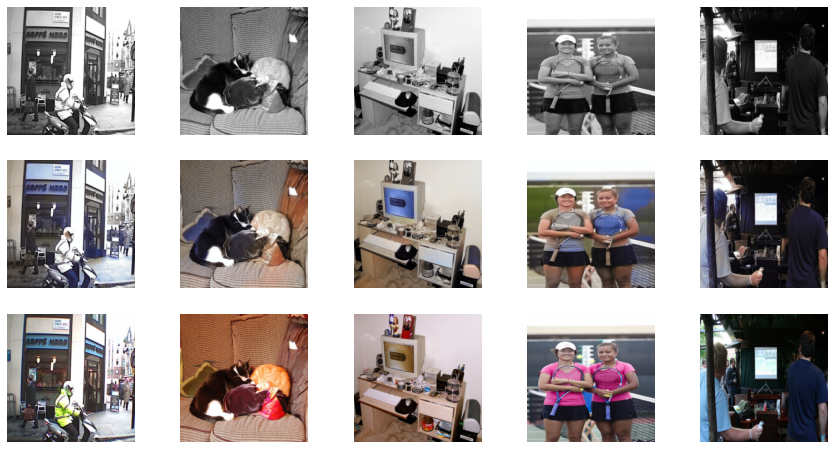


Epoch 1/20
Iteration 400/625
loss_D_fake: 0.6169
loss_D_real: 0.6161
loss_D: 0.6165
loss_G_GAN: 1.0092
loss_G_L1: 7.5555
loss_G: 8.5648


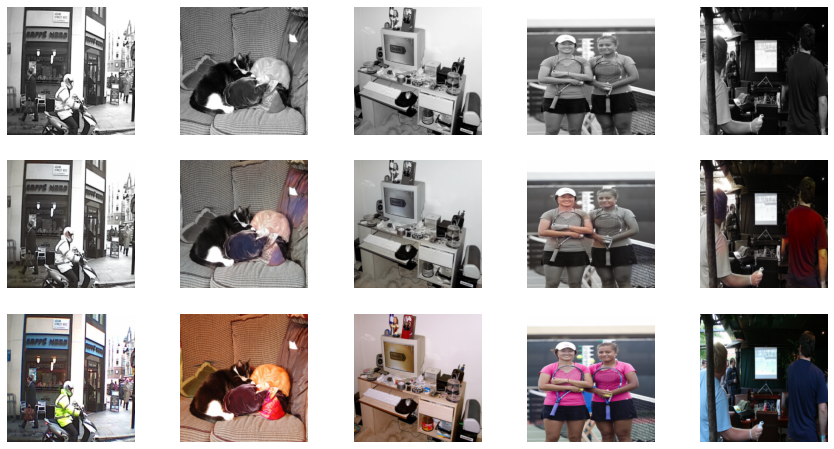


Epoch 1/20
Iteration 600/625
loss_D_fake: 0.6099
loss_D_real: 0.6077
loss_D: 0.6088
loss_G_GAN: 1.0411
loss_G_L1: 7.8034
loss_G: 8.8445


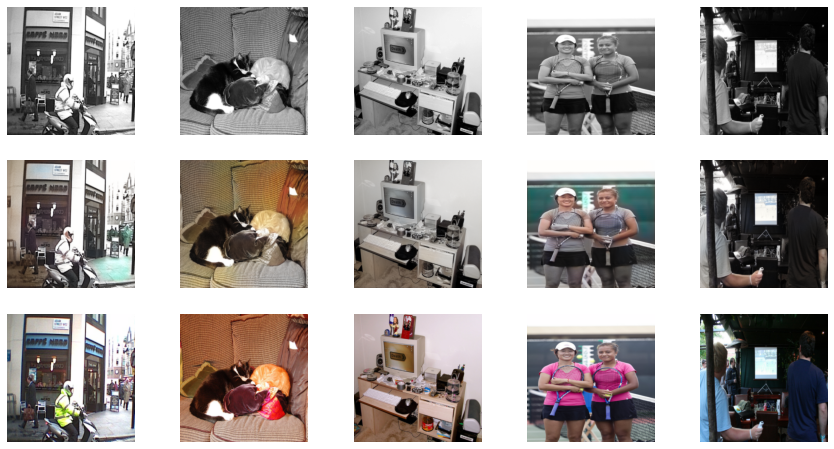


Epoch 2/20
Iteration 200/625
loss_D_fake: 0.6284
loss_D_real: 0.6115
loss_D: 0.6200
loss_G_GAN: 1.0192
loss_G_L1: 7.8115
loss_G: 8.8307


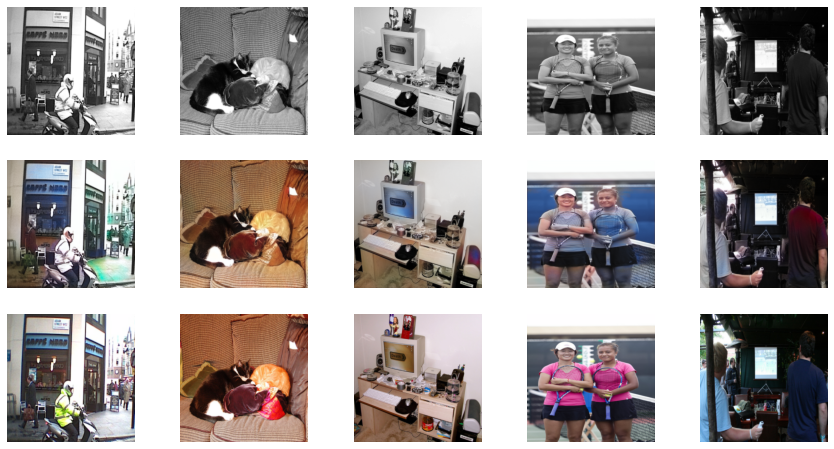


Epoch 2/20
Iteration 400/625
loss_D_fake: 0.6236
loss_D_real: 0.6171
loss_D: 0.6203
loss_G_GAN: 1.0145
loss_G_L1: 7.8900
loss_G: 8.9045


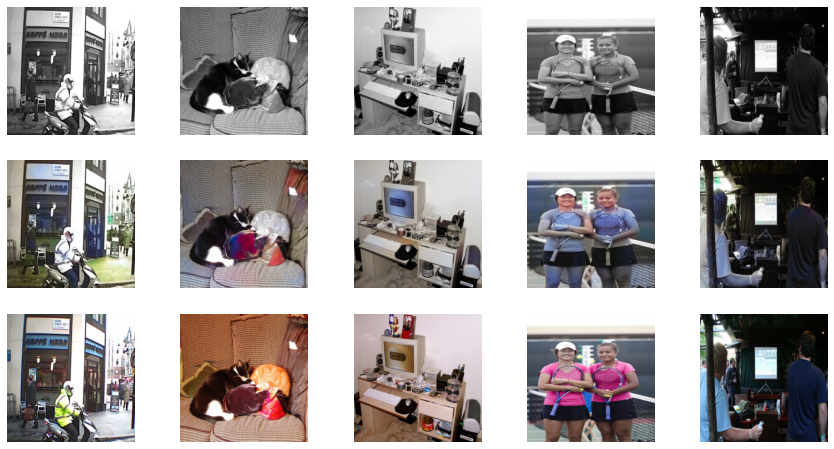


Epoch 2/20
Iteration 600/625
loss_D_fake: 0.6208
loss_D_real: 0.6175
loss_D: 0.6191
loss_G_GAN: 1.0121
loss_G_L1: 7.9047
loss_G: 8.9169


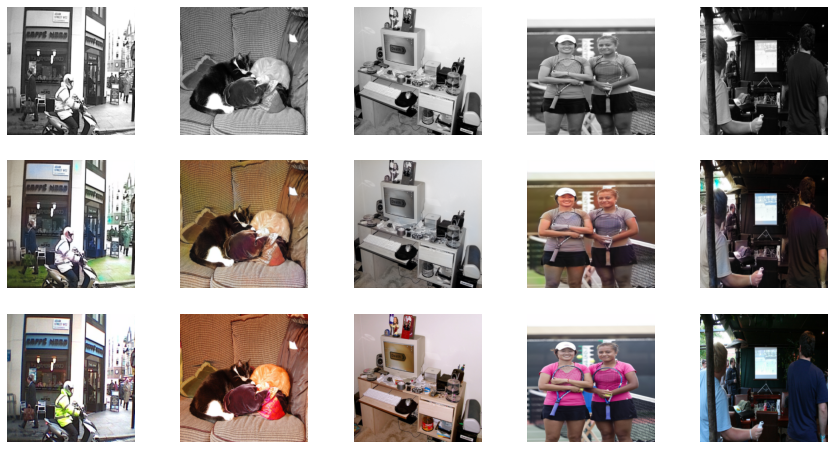


Epoch 3/20
Iteration 200/625
loss_D_fake: 0.6321
loss_D_real: 0.6302
loss_D: 0.6311
loss_G_GAN: 0.9780
loss_G_L1: 7.6451
loss_G: 8.6231


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


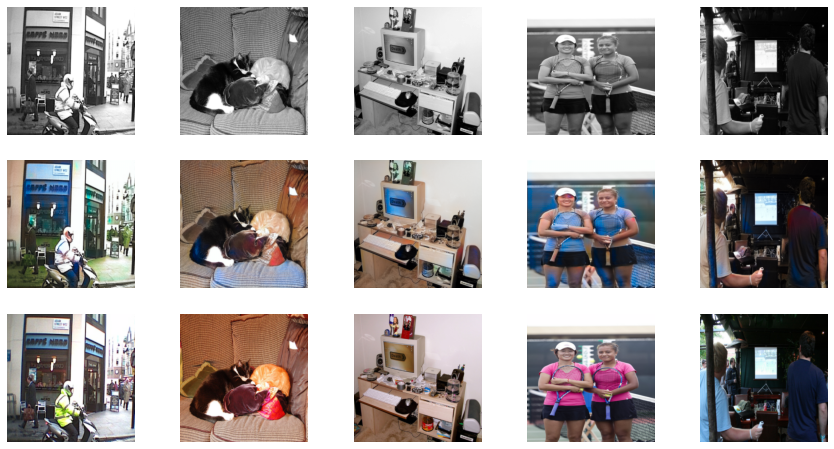


Epoch 3/20
Iteration 400/625
loss_D_fake: 0.6304
loss_D_real: 0.6336
loss_D: 0.6320
loss_G_GAN: 0.9656
loss_G_L1: 7.5852
loss_G: 8.5508


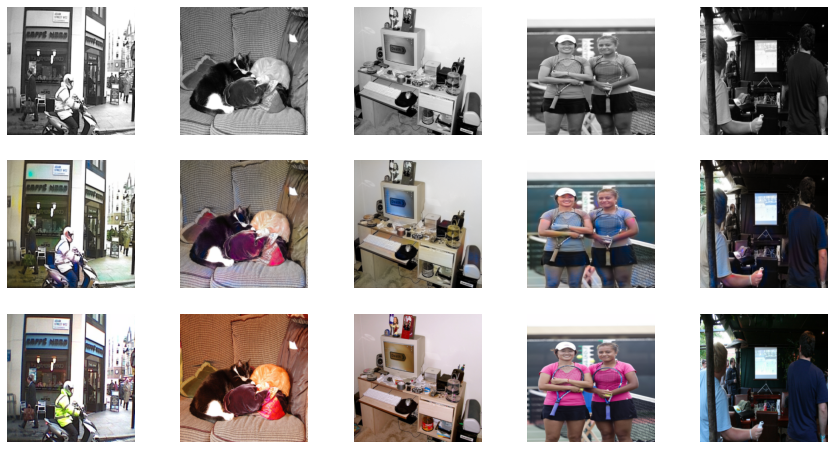


Epoch 3/20
Iteration 600/625
loss_D_fake: 0.6286
loss_D_real: 0.6339
loss_D: 0.6313
loss_G_GAN: 0.9636
loss_G_L1: 7.5737
loss_G: 8.5373


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 35 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 45 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


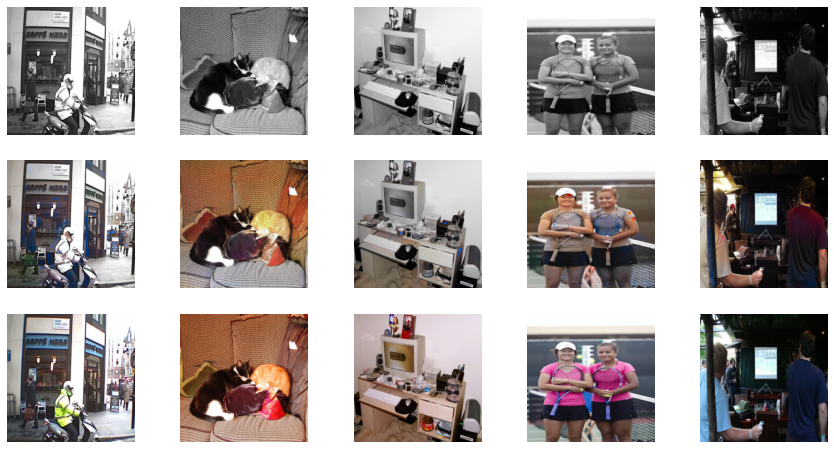


Epoch 4/20
Iteration 200/625
loss_D_fake: 0.6300
loss_D_real: 0.6394
loss_D: 0.6347
loss_G_GAN: 0.9357
loss_G_L1: 7.2758
loss_G: 8.2115


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


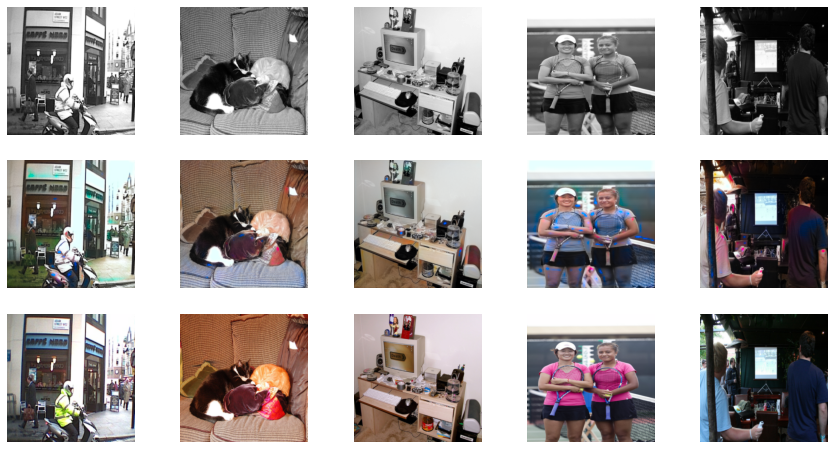


Epoch 4/20
Iteration 400/625
loss_D_fake: 0.6297
loss_D_real: 0.6428
loss_D: 0.6363
loss_G_GAN: 0.9393
loss_G_L1: 7.2746
loss_G: 8.2138


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


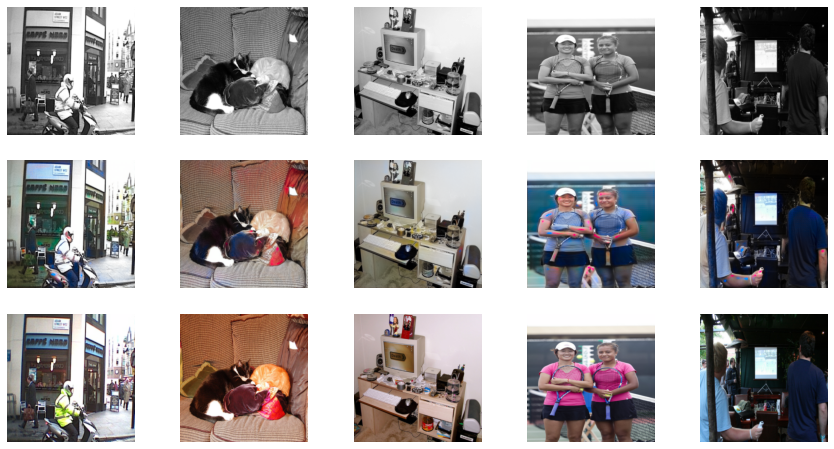


Epoch 4/20
Iteration 600/625
loss_D_fake: 0.6270
loss_D_real: 0.6430
loss_D: 0.6350
loss_G_GAN: 0.9390
loss_G_L1: 7.2921
loss_G: 8.2311


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


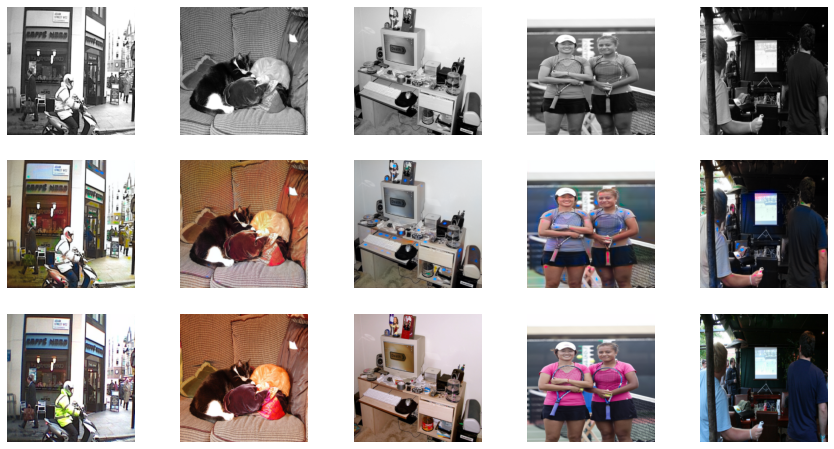


Epoch 5/20
Iteration 200/625
loss_D_fake: 0.6334
loss_D_real: 0.6338
loss_D: 0.6336
loss_G_GAN: 0.9322
loss_G_L1: 7.0694
loss_G: 8.0016


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


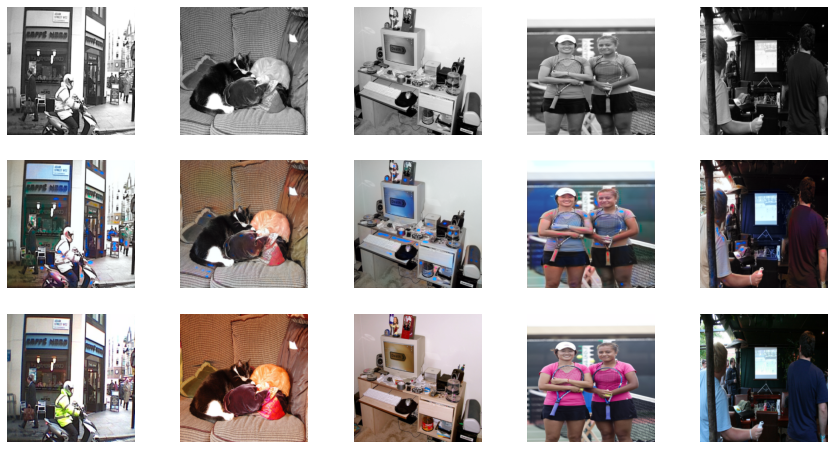


Epoch 5/20
Iteration 400/625
loss_D_fake: 0.6341
loss_D_real: 0.6381
loss_D: 0.6361
loss_G_GAN: 0.9299
loss_G_L1: 7.0425
loss_G: 7.9724


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


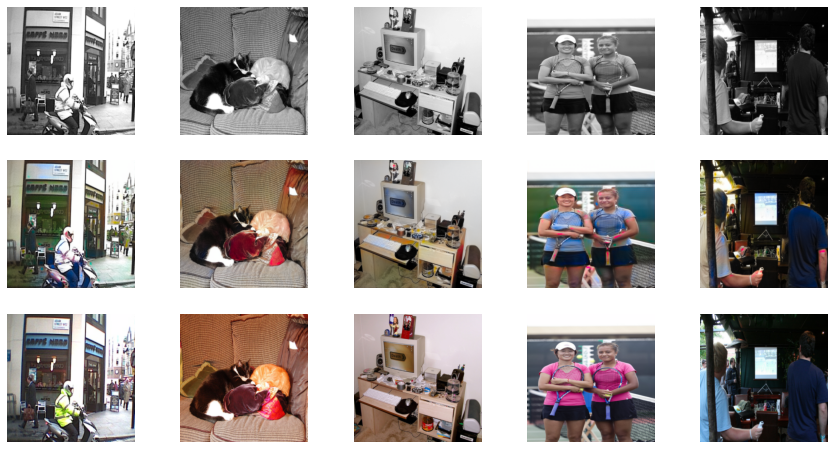


Epoch 5/20
Iteration 600/625
loss_D_fake: 0.6323
loss_D_real: 0.6390
loss_D: 0.6357
loss_G_GAN: 0.9279
loss_G_L1: 7.0518
loss_G: 7.9797


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


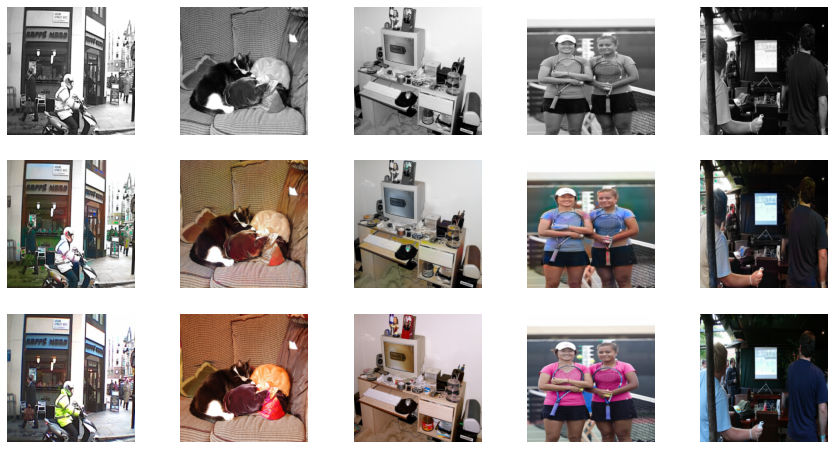


Epoch 6/20
Iteration 200/625
loss_D_fake: 0.6376
loss_D_real: 0.6416
loss_D: 0.6396
loss_G_GAN: 0.9074
loss_G_L1: 6.8530
loss_G: 7.7604


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


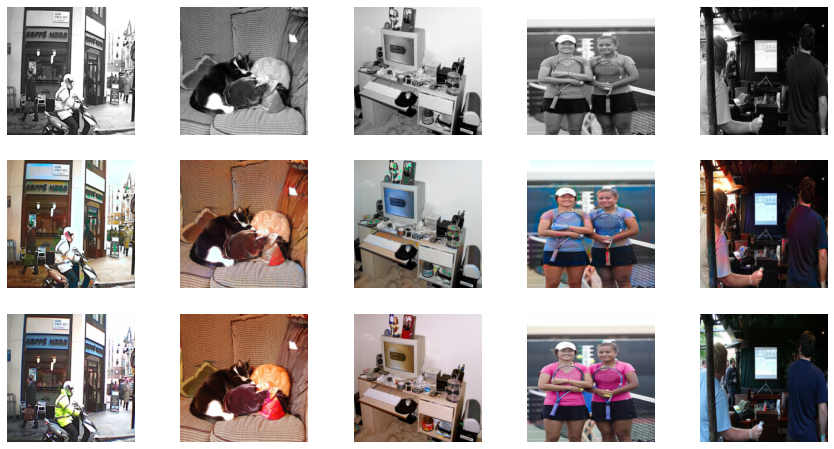


Epoch 6/20
Iteration 400/625
loss_D_fake: 0.6385
loss_D_real: 0.6447
loss_D: 0.6416
loss_G_GAN: 0.9062
loss_G_L1: 6.8573
loss_G: 7.7635


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 53 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 29 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 25 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color

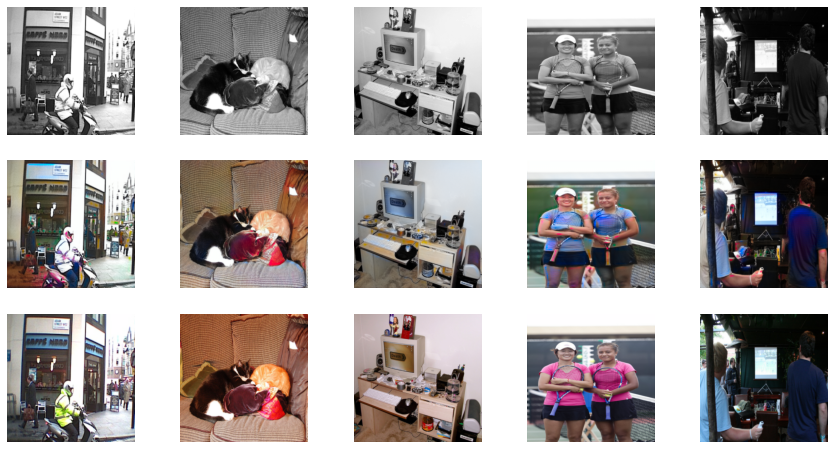


Epoch 6/20
Iteration 600/625
loss_D_fake: 0.6369
loss_D_real: 0.6434
loss_D: 0.6401
loss_G_GAN: 0.9076
loss_G_L1: 6.8427
loss_G: 7.7504


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


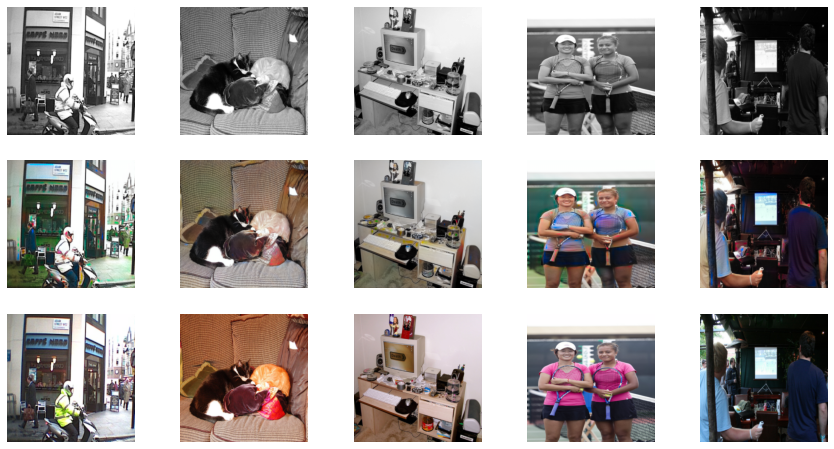


Epoch 7/20
Iteration 200/625
loss_D_fake: 0.6431
loss_D_real: 0.6447
loss_D: 0.6439
loss_G_GAN: 0.9006
loss_G_L1: 6.6213
loss_G: 7.5220


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


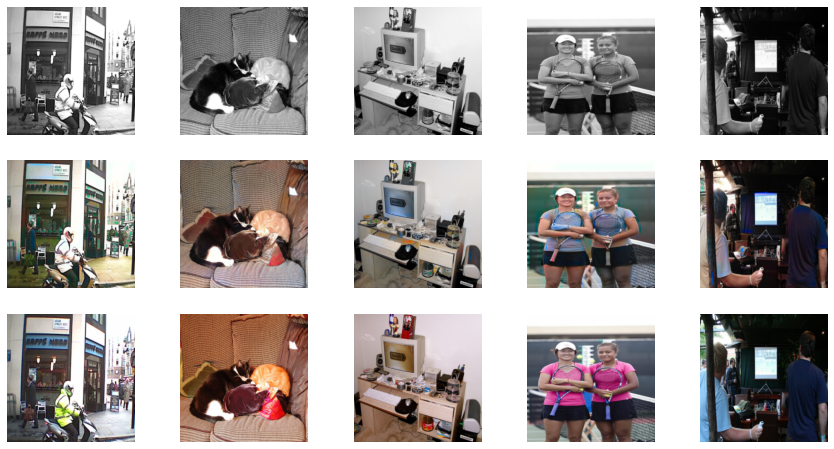


Epoch 7/20
Iteration 400/625
loss_D_fake: 0.6416
loss_D_real: 0.6454
loss_D: 0.6435
loss_G_GAN: 0.8975
loss_G_L1: 6.6250
loss_G: 7.5225


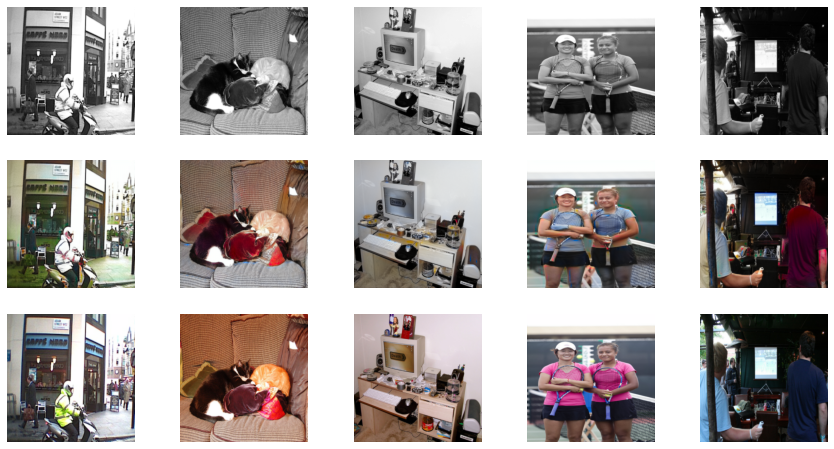


Epoch 7/20
Iteration 600/625
loss_D_fake: 0.6405
loss_D_real: 0.6442
loss_D: 0.6423
loss_G_GAN: 0.8952
loss_G_L1: 6.6307
loss_G: 7.5259


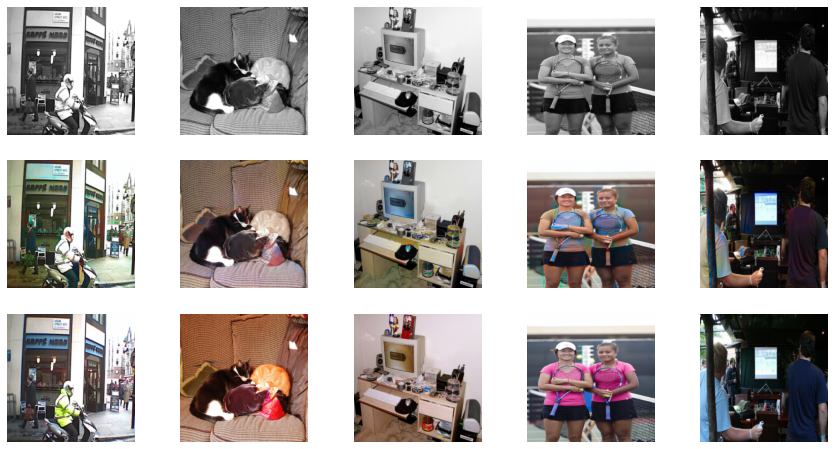


Epoch 8/20
Iteration 200/625
loss_D_fake: 0.6477
loss_D_real: 0.6446
loss_D: 0.6462
loss_G_GAN: 0.8804
loss_G_L1: 6.4669
loss_G: 7.3473


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


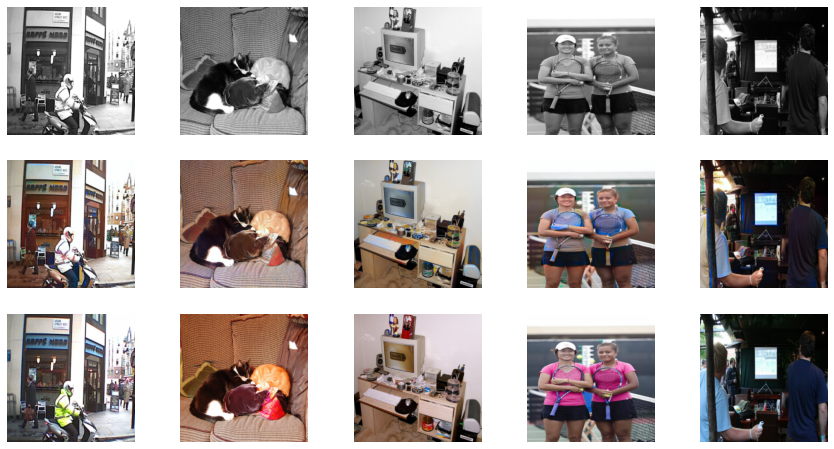


Epoch 8/20
Iteration 400/625
loss_D_fake: 0.6463
loss_D_real: 0.6472
loss_D: 0.6467
loss_G_GAN: 0.8790
loss_G_L1: 6.4618
loss_G: 7.3409


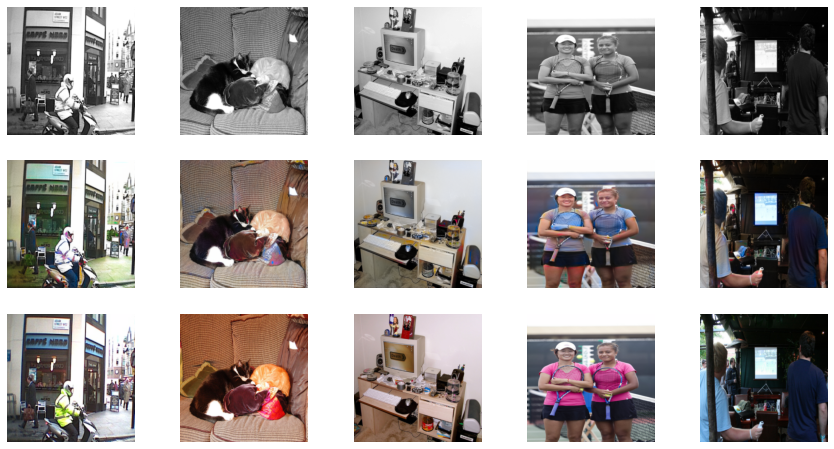


Epoch 8/20
Iteration 600/625
loss_D_fake: 0.6457
loss_D_real: 0.6462
loss_D: 0.6460
loss_G_GAN: 0.8789
loss_G_L1: 6.4580
loss_G: 7.3369


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1068: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


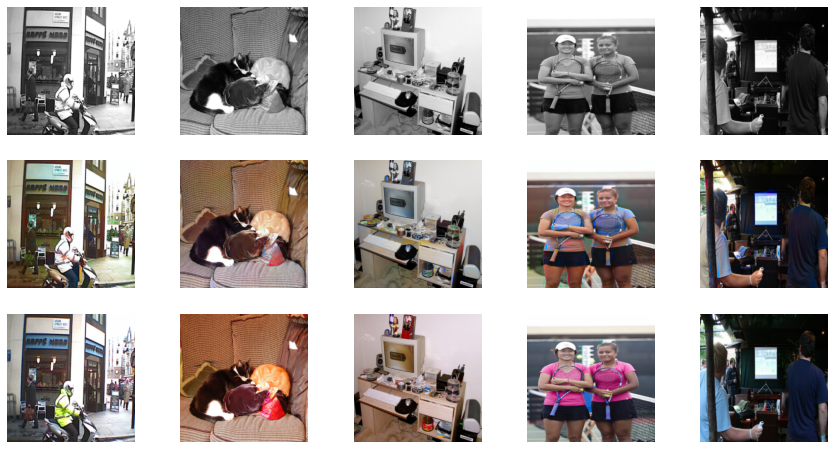


Epoch 9/20
Iteration 200/625
loss_D_fake: 0.6545
loss_D_real: 0.6492
loss_D: 0.6519
loss_G_GAN: 0.8695
loss_G_L1: 6.3350
loss_G: 7.2044


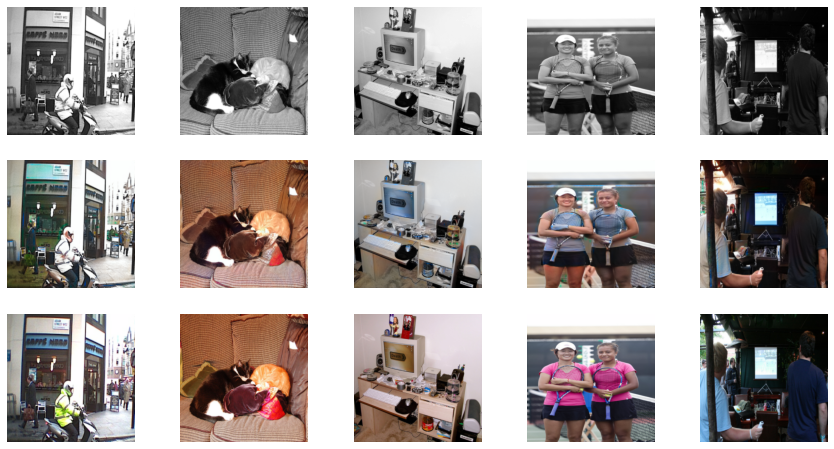


Epoch 9/20
Iteration 400/625
loss_D_fake: 0.6495
loss_D_real: 0.6529
loss_D: 0.6512
loss_G_GAN: 0.8671
loss_G_L1: 6.3021
loss_G: 7.1693


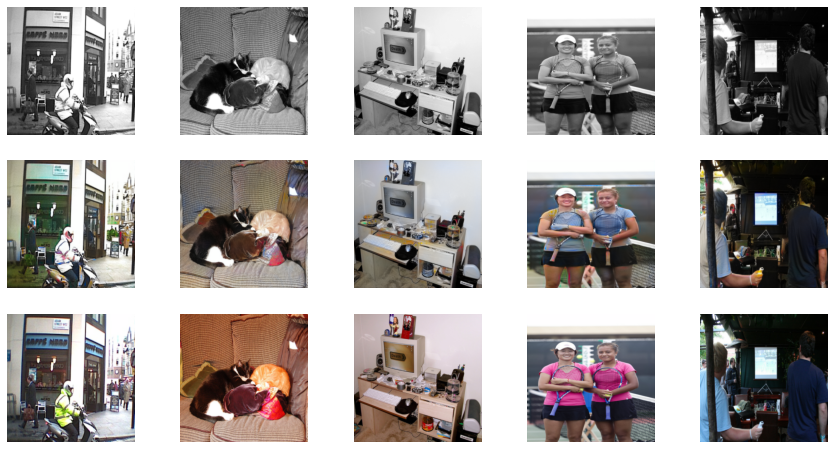


Epoch 9/20
Iteration 600/625
loss_D_fake: 0.6466
loss_D_real: 0.6534
loss_D: 0.6500
loss_G_GAN: 0.8688
loss_G_L1: 6.3052
loss_G: 7.1740


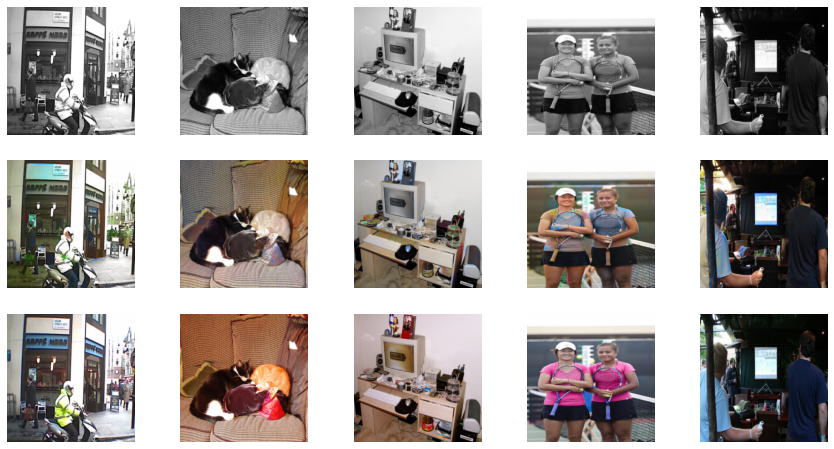


Epoch 10/20
Iteration 200/625
loss_D_fake: 0.6544
loss_D_real: 0.6473
loss_D: 0.6509
loss_G_GAN: 0.8613
loss_G_L1: 6.1769
loss_G: 7.0382


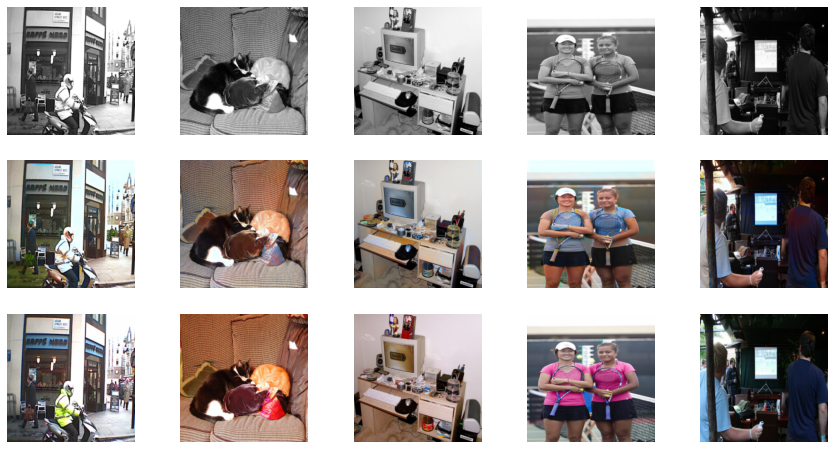


Epoch 10/20
Iteration 400/625
loss_D_fake: 0.6513
loss_D_real: 0.6527
loss_D: 0.6520
loss_G_GAN: 0.8597
loss_G_L1: 6.1547
loss_G: 7.0144


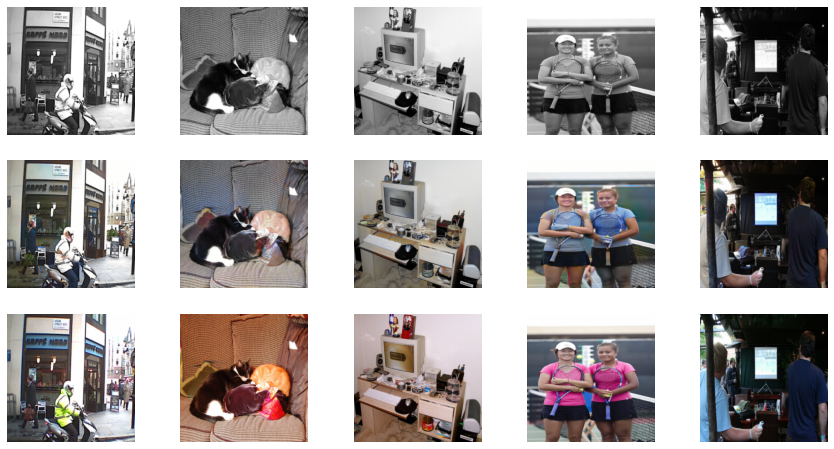


Epoch 10/20
Iteration 600/625
loss_D_fake: 0.6493
loss_D_real: 0.6505
loss_D: 0.6499
loss_G_GAN: 0.8604
loss_G_L1: 6.1559
loss_G: 7.0163


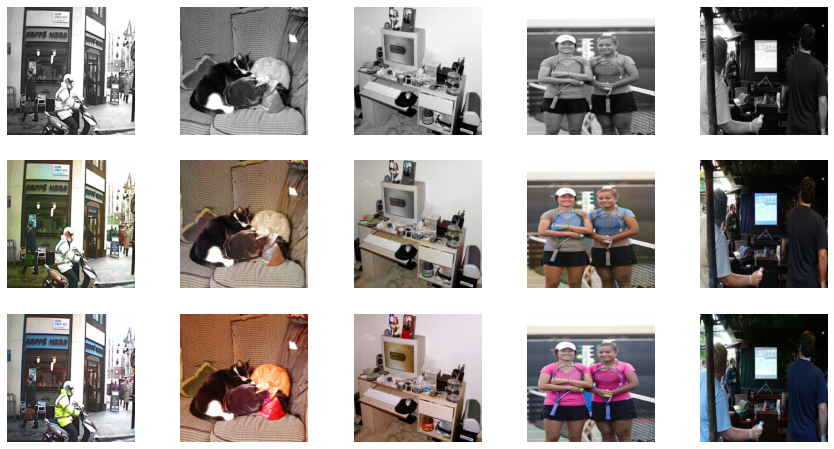


Epoch 11/20
Iteration 200/625
loss_D_fake: 0.6532
loss_D_real: 0.6529
loss_D: 0.6531
loss_G_GAN: 0.8554
loss_G_L1: 6.0241
loss_G: 6.8795


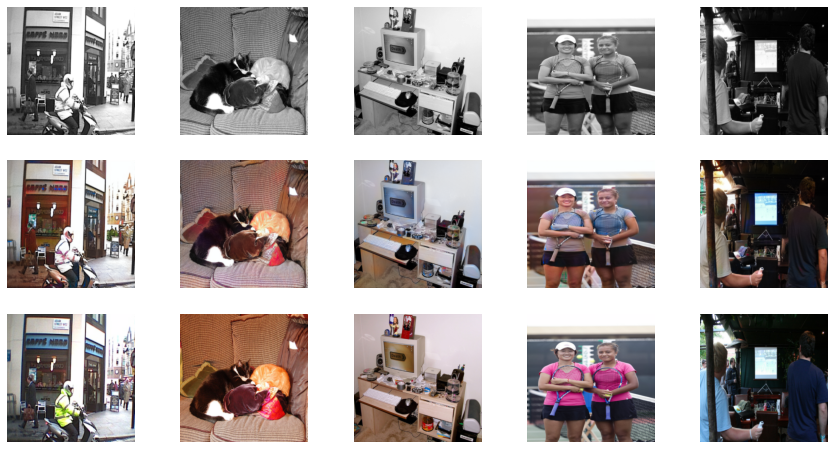


Epoch 11/20
Iteration 400/625
loss_D_fake: 0.6527
loss_D_real: 0.6530
loss_D: 0.6529
loss_G_GAN: 0.8513
loss_G_L1: 6.0127
loss_G: 6.8640


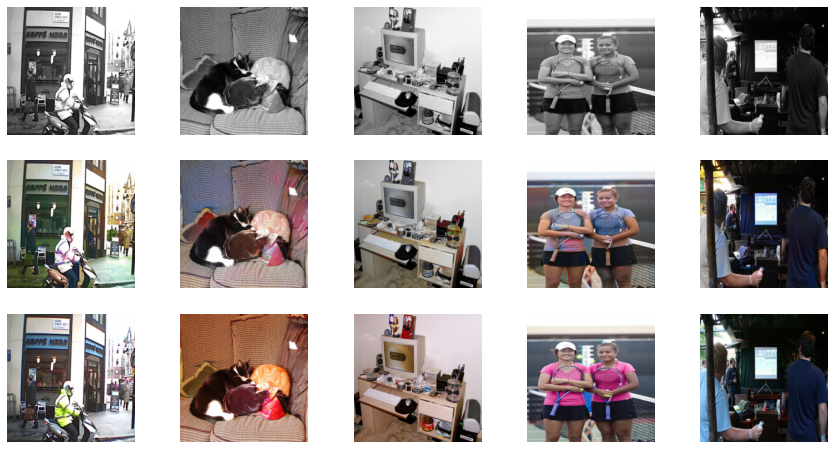


Epoch 11/20
Iteration 600/625
loss_D_fake: 0.6508
loss_D_real: 0.6531
loss_D: 0.6520
loss_G_GAN: 0.8516
loss_G_L1: 6.0159
loss_G: 6.8675


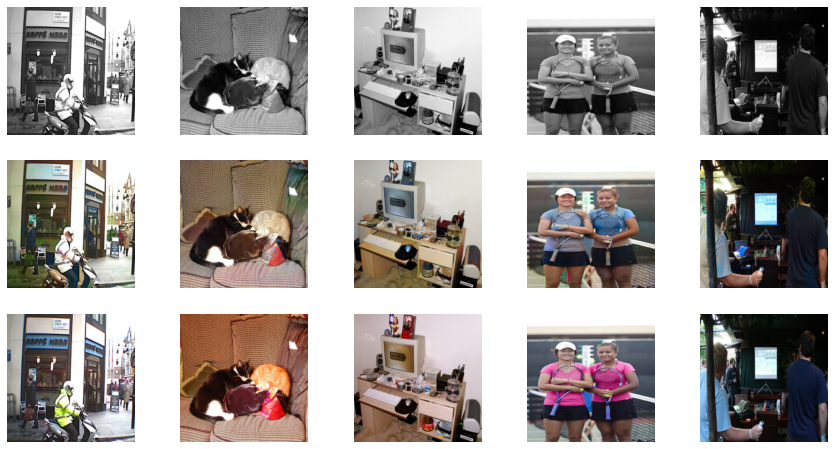


Epoch 12/20
Iteration 200/625
loss_D_fake: 0.6520
loss_D_real: 0.6562
loss_D: 0.6541
loss_G_GAN: 0.8485
loss_G_L1: 5.8849
loss_G: 6.7334


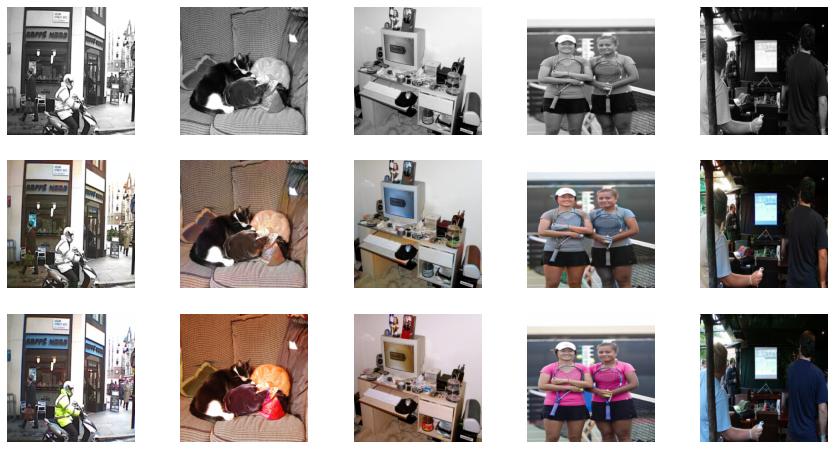


Epoch 12/20
Iteration 400/625
loss_D_fake: 0.6531
loss_D_real: 0.6552
loss_D: 0.6541
loss_G_GAN: 0.8456
loss_G_L1: 5.8800
loss_G: 6.7256


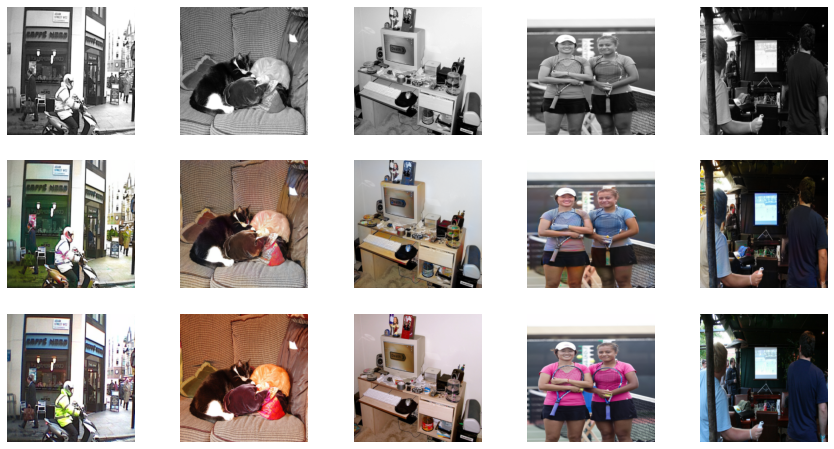


Epoch 12/20
Iteration 600/625
loss_D_fake: 0.6518
loss_D_real: 0.6553
loss_D: 0.6536
loss_G_GAN: 0.8439
loss_G_L1: 5.8815
loss_G: 6.7254


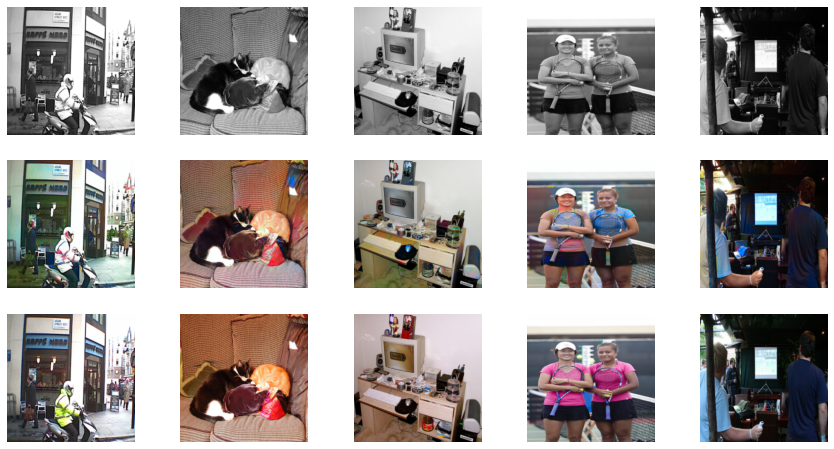


Epoch 13/20
Iteration 200/625
loss_D_fake: 0.6556
loss_D_real: 0.6561
loss_D: 0.6558
loss_G_GAN: 0.8404
loss_G_L1: 5.8056
loss_G: 6.6460


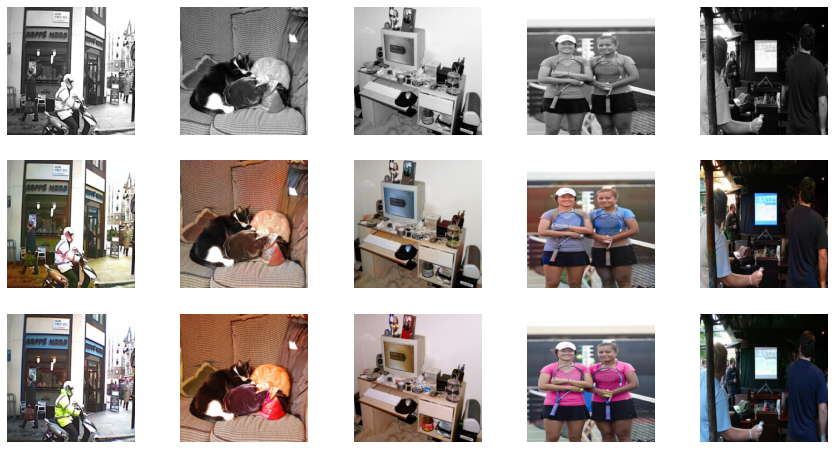


Epoch 13/20
Iteration 400/625
loss_D_fake: 0.6550
loss_D_real: 0.6565
loss_D: 0.6558
loss_G_GAN: 0.8378
loss_G_L1: 5.7778
loss_G: 6.6156


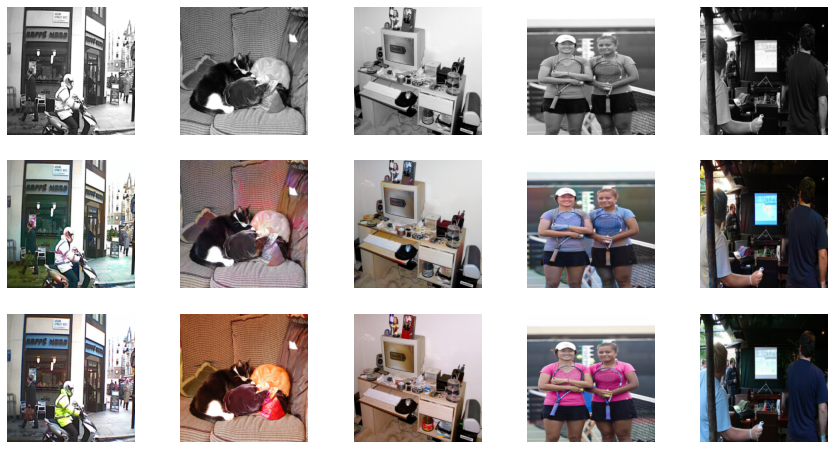


Epoch 13/20
Iteration 600/625
loss_D_fake: 0.6529
loss_D_real: 0.6566
loss_D: 0.6548
loss_G_GAN: 0.8389
loss_G_L1: 5.7660
loss_G: 6.6049


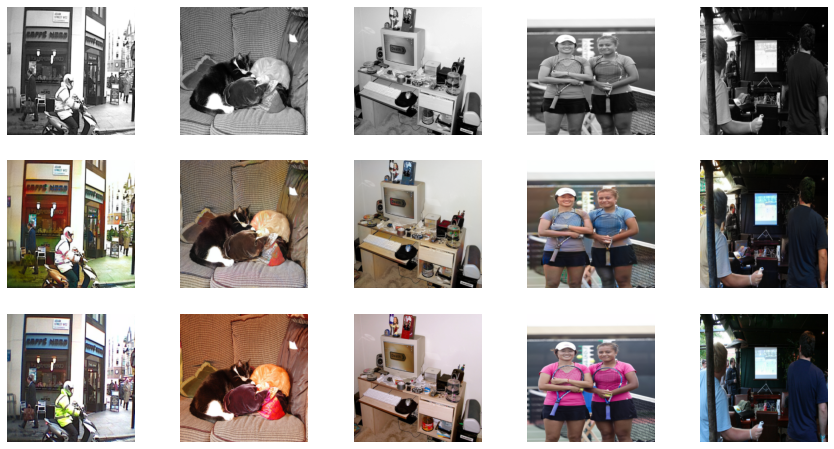


Epoch 14/20
Iteration 200/625
loss_D_fake: 0.6590
loss_D_real: 0.6545
loss_D: 0.6567
loss_G_GAN: 0.8375
loss_G_L1: 5.6339
loss_G: 6.4714


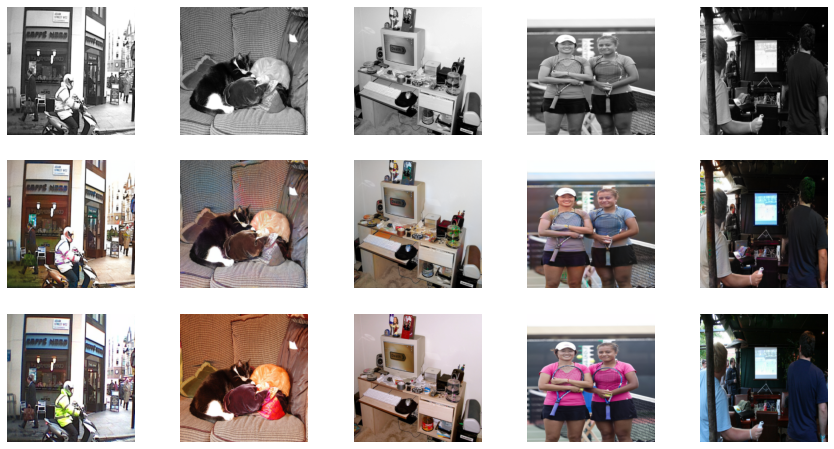


Epoch 14/20
Iteration 400/625
loss_D_fake: 0.6565
loss_D_real: 0.6579
loss_D: 0.6572
loss_G_GAN: 0.8327
loss_G_L1: 5.6147
loss_G: 6.4473


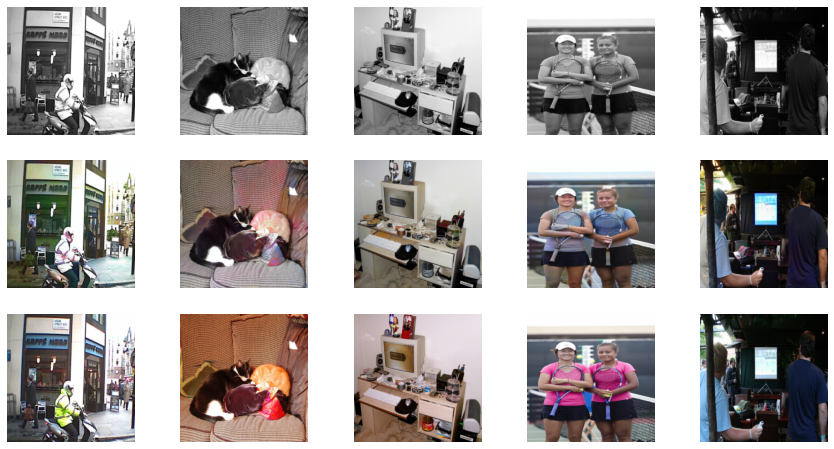


Epoch 14/20
Iteration 600/625
loss_D_fake: 0.6548
loss_D_real: 0.6571
loss_D: 0.6559
loss_G_GAN: 0.8343
loss_G_L1: 5.6240
loss_G: 6.4583


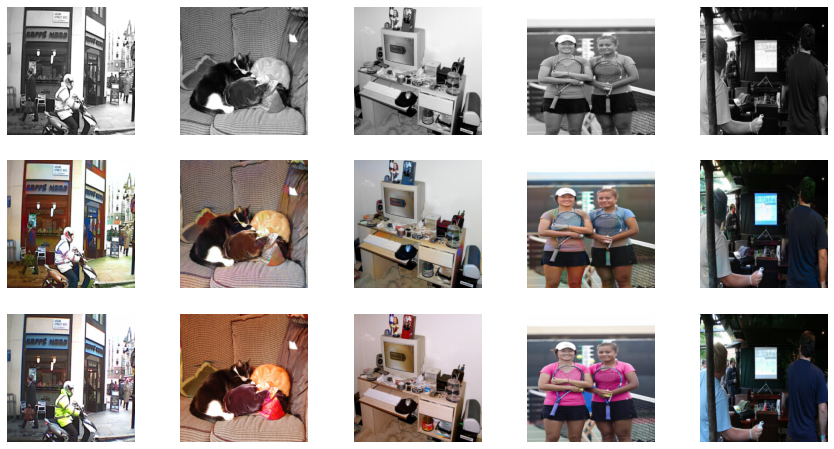


Epoch 15/20
Iteration 200/625
loss_D_fake: 0.6571
loss_D_real: 0.6578
loss_D: 0.6575
loss_G_GAN: 0.8294
loss_G_L1: 5.5415
loss_G: 6.3709


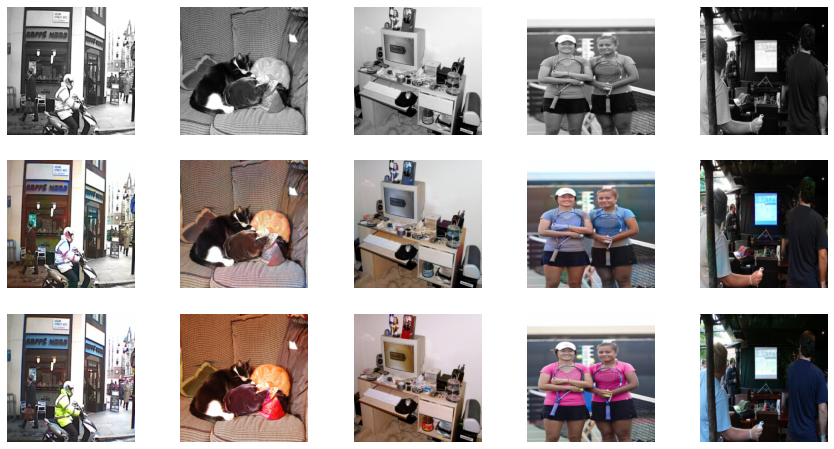


Epoch 15/20
Iteration 400/625
loss_D_fake: 0.6563
loss_D_real: 0.6581
loss_D: 0.6572
loss_G_GAN: 0.8276
loss_G_L1: 5.5292
loss_G: 6.3569


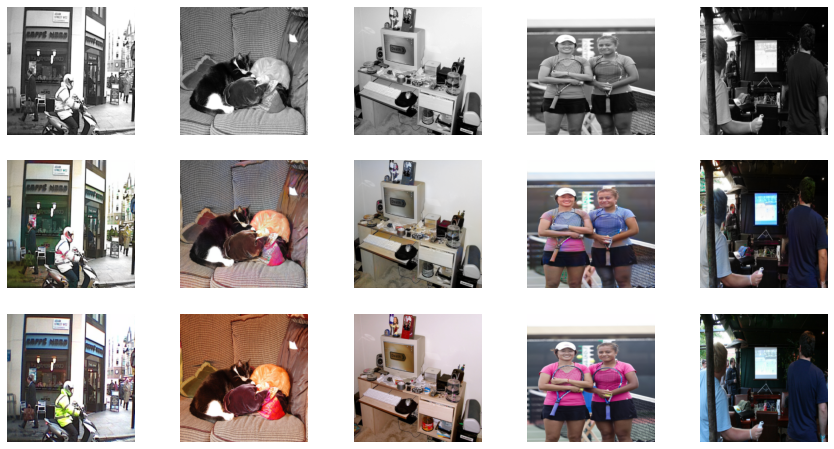


Epoch 15/20
Iteration 600/625
loss_D_fake: 0.6553
loss_D_real: 0.6587
loss_D: 0.6570
loss_G_GAN: 0.8294
loss_G_L1: 5.5419
loss_G: 6.3713


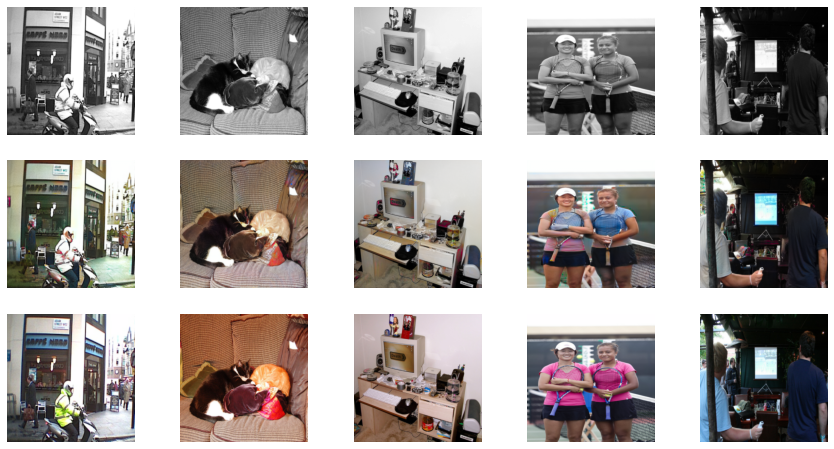


Epoch 16/20
Iteration 200/625
loss_D_fake: 0.6577
loss_D_real: 0.6589
loss_D: 0.6583
loss_G_GAN: 0.8280
loss_G_L1: 5.4461
loss_G: 6.2740


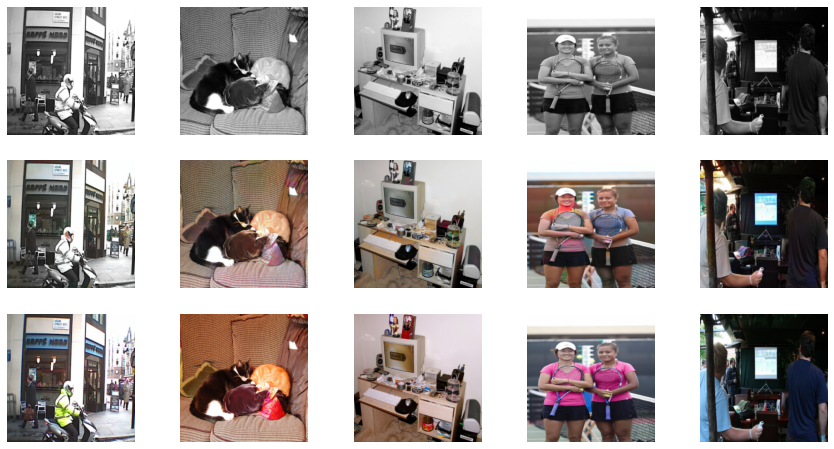


Epoch 16/20
Iteration 400/625
loss_D_fake: 0.6574
loss_D_real: 0.6602
loss_D: 0.6588
loss_G_GAN: 0.8273
loss_G_L1: 5.4319
loss_G: 6.2593


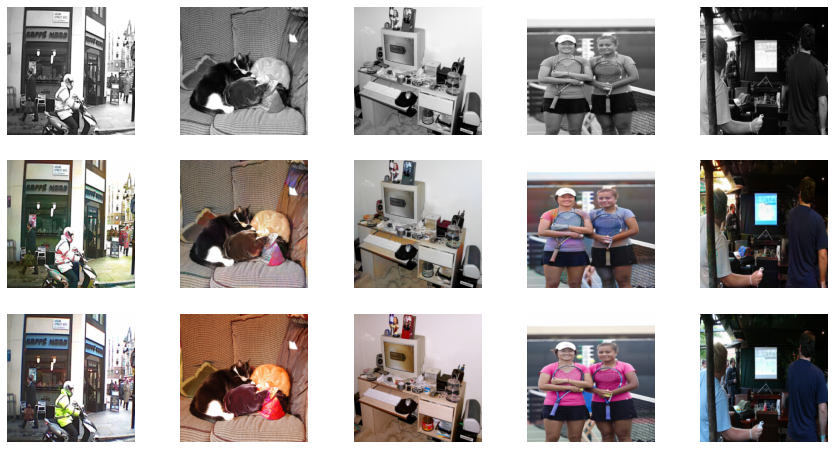


Epoch 16/20
Iteration 600/625
loss_D_fake: 0.6559
loss_D_real: 0.6593
loss_D: 0.6576
loss_G_GAN: 0.8279
loss_G_L1: 5.4321
loss_G: 6.2601


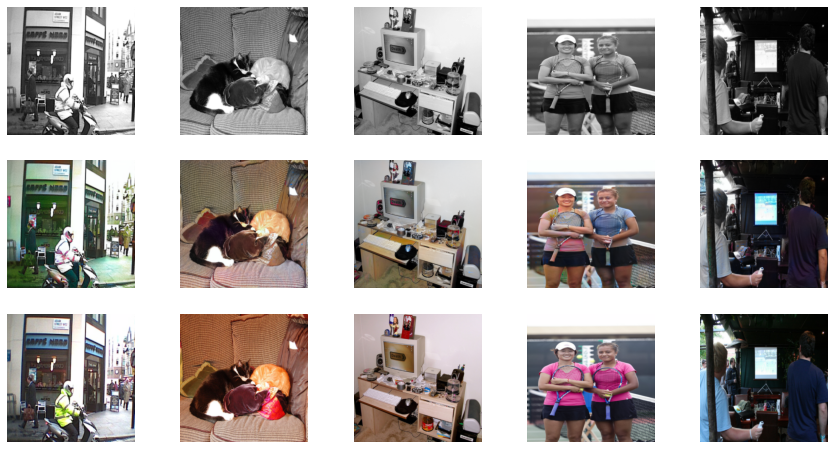


Epoch 17/20
Iteration 200/625
loss_D_fake: 0.6590
loss_D_real: 0.6601
loss_D: 0.6595
loss_G_GAN: 0.8228
loss_G_L1: 5.3502
loss_G: 6.1730


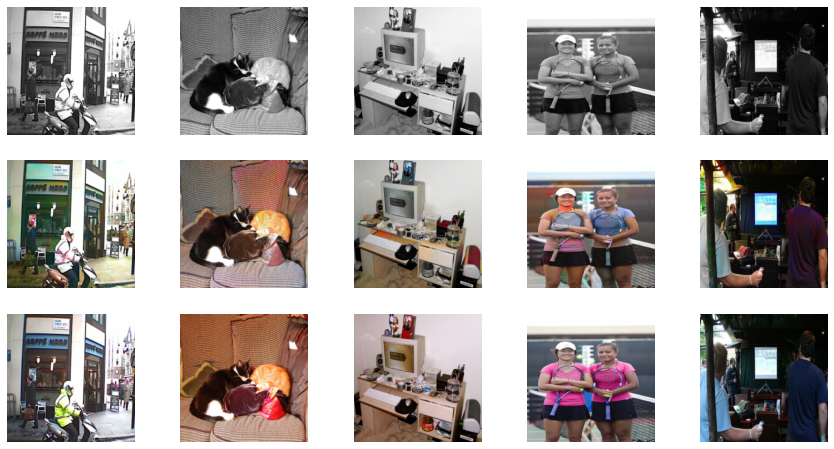


Epoch 17/20
Iteration 400/625
loss_D_fake: 0.6597
loss_D_real: 0.6604
loss_D: 0.6600
loss_G_GAN: 0.8212
loss_G_L1: 5.3283
loss_G: 6.1495


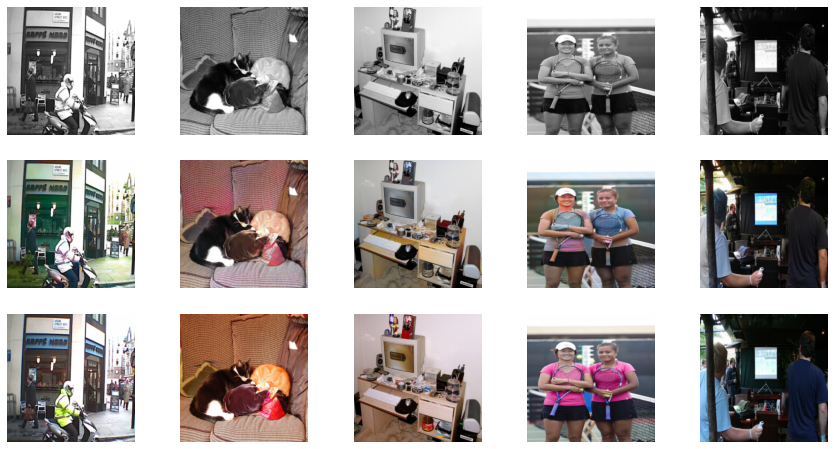


Epoch 17/20
Iteration 600/625
loss_D_fake: 0.6571
loss_D_real: 0.6602
loss_D: 0.6587
loss_G_GAN: 0.8232
loss_G_L1: 5.3208
loss_G: 6.1440


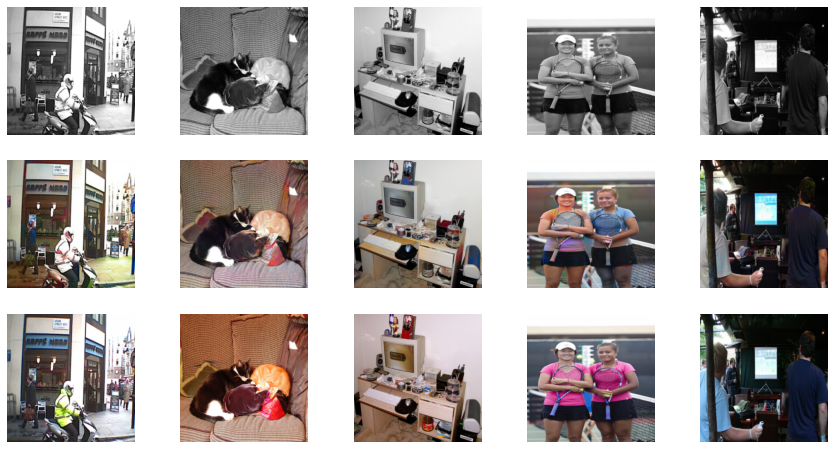


Epoch 18/20
Iteration 200/625
loss_D_fake: 0.6612
loss_D_real: 0.6573
loss_D: 0.6593
loss_G_GAN: 0.8177
loss_G_L1: 5.2498
loss_G: 6.0675


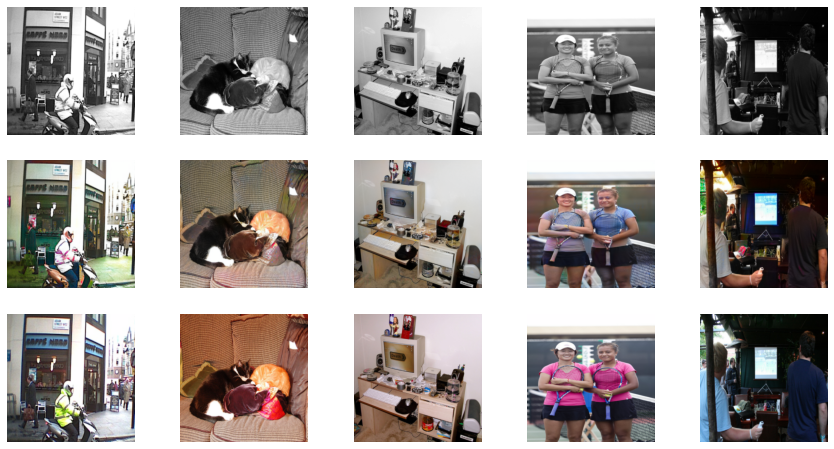


Epoch 18/20
Iteration 400/625
loss_D_fake: 0.6601
loss_D_real: 0.6594
loss_D: 0.6597
loss_G_GAN: 0.8158
loss_G_L1: 5.2159
loss_G: 6.0317


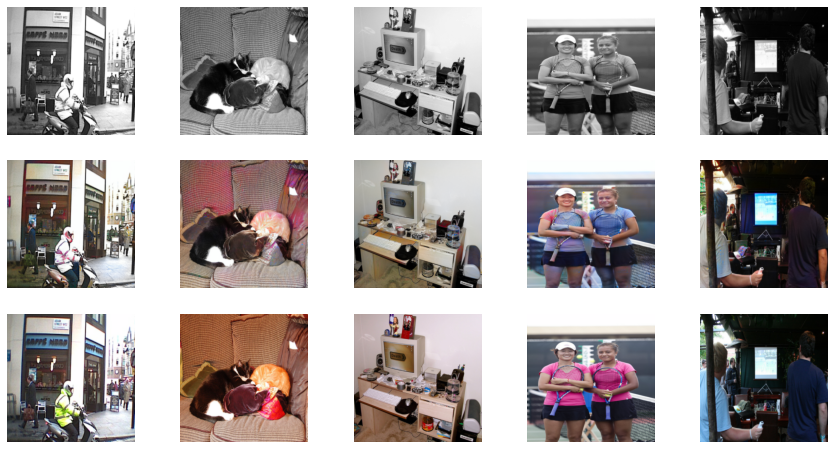


Epoch 18/20
Iteration 600/625
loss_D_fake: 0.6582
loss_D_real: 0.6601
loss_D: 0.6592
loss_G_GAN: 0.8178
loss_G_L1: 5.2121
loss_G: 6.0299


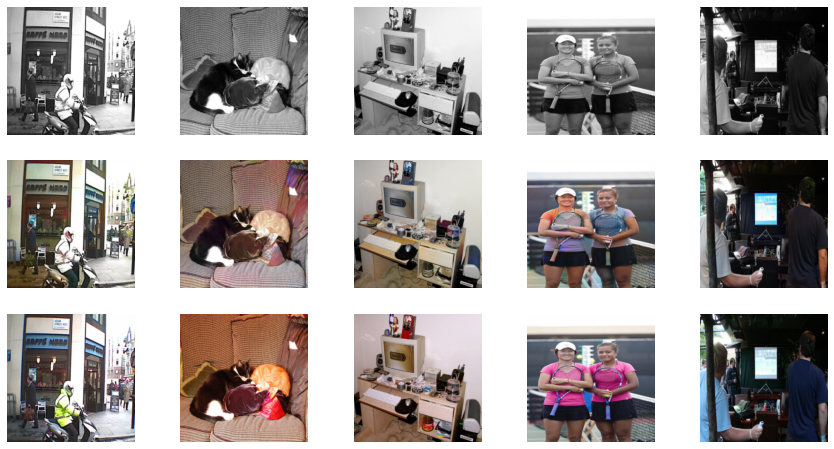


Epoch 19/20
Iteration 200/625
loss_D_fake: 0.6634
loss_D_real: 0.6582
loss_D: 0.6608
loss_G_GAN: 0.8200
loss_G_L1: 5.1674
loss_G: 5.9874


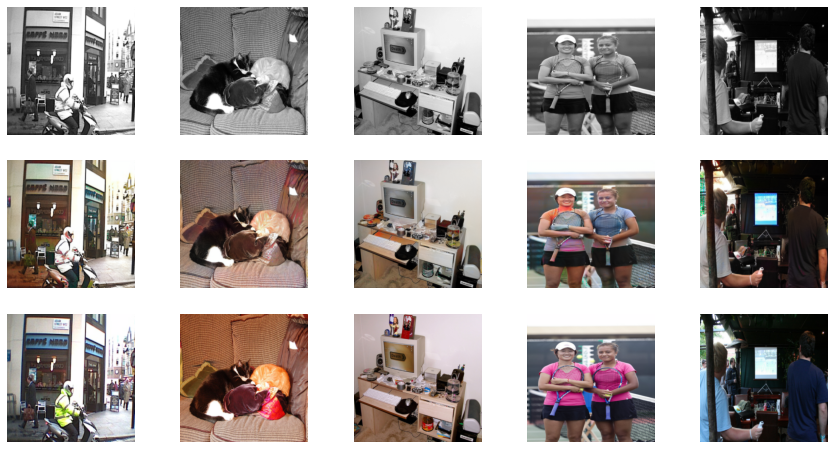


Epoch 19/20
Iteration 400/625
loss_D_fake: 0.6607
loss_D_real: 0.6612
loss_D: 0.6610
loss_G_GAN: 0.8164
loss_G_L1: 5.1293
loss_G: 5.9456


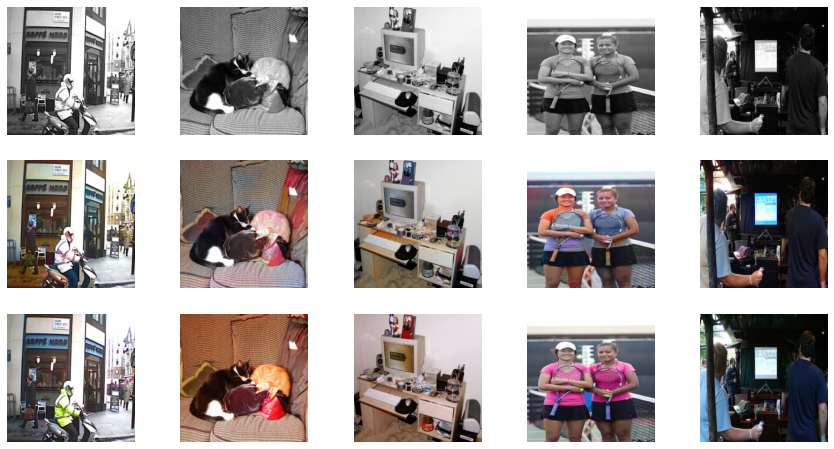


Epoch 19/20
Iteration 600/625
loss_D_fake: 0.6585
loss_D_real: 0.6611
loss_D: 0.6598
loss_G_GAN: 0.8178
loss_G_L1: 5.1147
loss_G: 5.9325


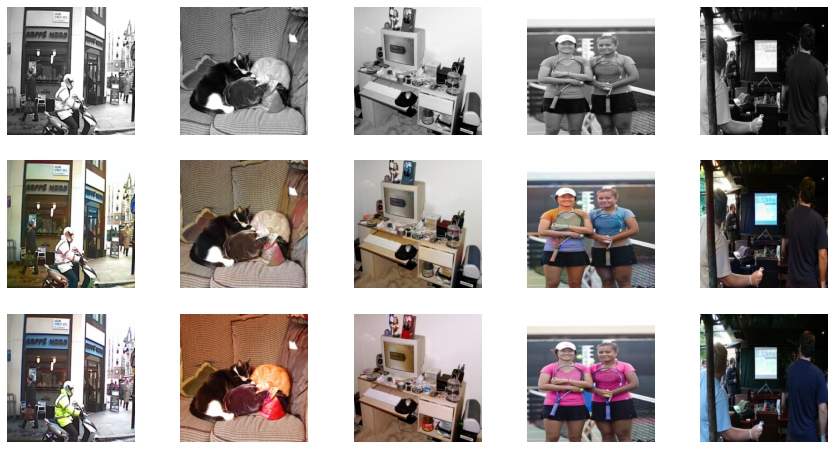


Epoch 20/20
Iteration 200/625
loss_D_fake: 0.6589
loss_D_real: 0.6651
loss_D: 0.6620
loss_G_GAN: 0.8132
loss_G_L1: 5.0869
loss_G: 5.9002


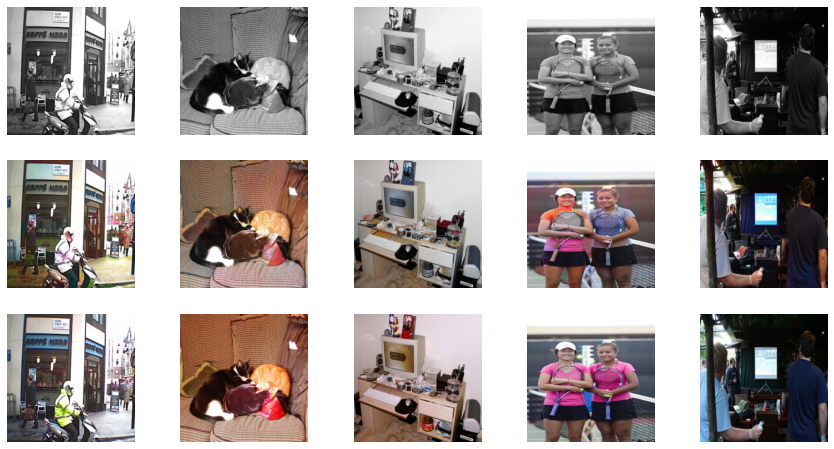


Epoch 20/20
Iteration 400/625
loss_D_fake: 0.6594
loss_D_real: 0.6649
loss_D: 0.6621
loss_G_GAN: 0.8130
loss_G_L1: 5.0655
loss_G: 5.8785


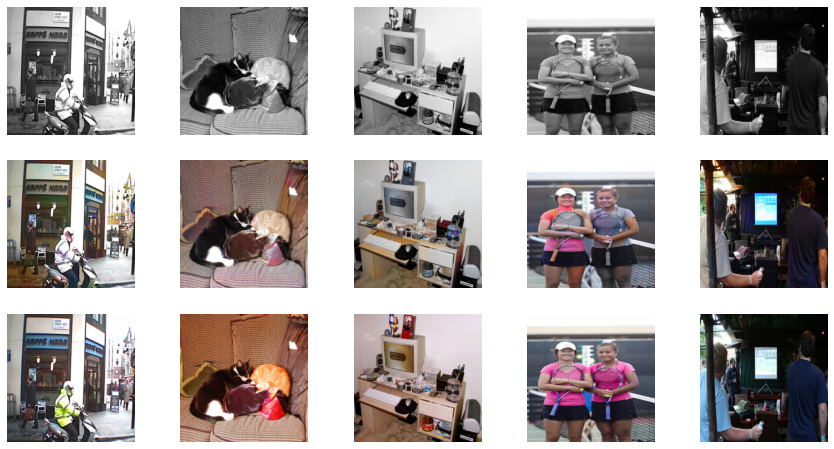


Epoch 20/20
Iteration 600/625
loss_D_fake: 0.6574
loss_D_real: 0.6643
loss_D: 0.6608
loss_G_GAN: 0.8143
loss_G_L1: 5.0598
loss_G: 5.8741


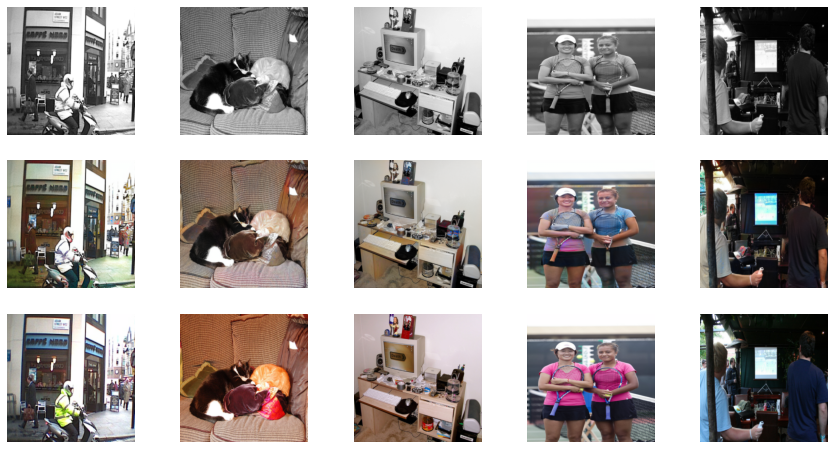

In [ ]:
train_model(model, train_dl, val_dl, 20)

In [ ]:
# from google.colab import drive
# drive.mount('./drive')